In [1]:
import os
import random
import pandas as pd
import numpy as np
import datetime
from matplotlib import pyplot as plt
from IPython.display import display
from scipy.optimize import minimize

In [2]:
base_context = 'fivethirtyeight'

def fast_hist(data, n=30, ax=None, figsize=(12, 4), title='', alpha=1, label='', new_figure=True):    
    with plt.style.context(base_context):
        if new_figure:
            plt.figure(figsize=figsize)
        data.hist(bins=n, ax=ax, figsize=figsize, alpha=alpha, label=label)
        plt.title(title);
        
def fast_plot(data, rolling=1, alpha=0.5, figsize=(12, 4), new_figure=True, title=None, label=None):    
    data = data.rolling(rolling).mean()    
    with plt.style.context(base_context):
        if new_figure:
            plt.figure(figsize=figsize)
        plt.scatter(data.index, data, alpha=alpha)
        plt.plot(data.index, data, linewidth=0.5, label=label)
        if title is not None:
            plt.title(title) 
            
def display_series(data, name=' '):
    df = data.to_frame().T
    df.index = [name]
    display(df)

# Загрузка данных

In [3]:
train_features = pd.read_csv('data/train_features.csv', index_col='timestamp', parse_dates=True)
train_targets = pd.read_csv('data/train_targets.csv', index_col='timestamp', parse_dates=True)
test_features = pd.read_csv('data/test_features.csv', index_col='timestamp', parse_dates=True)
submission = pd.read_csv('data/sample_submission.csv', index_col='timestamp', parse_dates=True)
print('Train features shape:', train_features.shape)
print('Train targets shape:', train_targets.shape)
print('Test features shape:', test_features.shape)
print('Submission shape:', submission.shape)

Train features shape: (5808, 10)
Train targets shape: (5808, 4)
Test features shape: (3984, 10)
Submission shape: (3984, 4)


# 1. Baseline model

In [4]:
train = pd.read_csv('data/dataset_filtered_1.csv', index_col='timestamp', parse_dates=True)
features = ['A_C2H6', 'A_C3H8', 'A_iC4H10', 'A_nC4H10']
targets = train_targets.columns

In [5]:
targets = train_targets.columns

train_mask = ((train.index > '2020-02-15') & (train.index < '2020-03-19') & (train[targets].sum(axis=1) > 0)) | \
    ((train.index > '2020-03-22') & (train.index < '2020-04-06') & (train[targets].sum(axis=1) > 0))

train_targets_mask = ((train_targets.index > '2020-02-15') & (train_targets.index < '2020-03-19') &
                      (train_targets.sum(axis=1) > 0)) | \
                     ((train_targets.index > '2020-03-22') & (train_targets.index < '2020-04-06') & 
                      (train_targets.sum(axis=1) > 0)) 

In [6]:
def metric_value(y, y_pred):
    return ((y - y_pred)/y).abs().mean()

def mean_metric(y_data, pred_data):
    summary = []
    for col in y_data:
        summary.append(metric_value(y_data[col], pred_data[col]))
        
    return summary

In [7]:
def get_value_by_flow(data, feature, cut_feature, low, high):
    mask = (data[cut_feature] > low) & (data[cut_feature] < high)
    if mask.sum() > 0:
        result = (data[feature][mask] * data['B_rate'][mask]).sum() / data['B_rate'][mask].sum()
        return result
    else:
        return np.NaN

In [8]:
def predict(data, feature, cut_feature, low=13440, high=13150):
    data = data.copy()
    data['Pred'] = np.NaN
    
    for i in range(data.shape[0]): 
        value  =  get_value_by_flow(data, feature, cut_feature, 
                                    data.iloc[i][cut_feature] - low,
                                    data.iloc[i][cut_feature] - high)
        if value > 0:
            data['Pred'].iloc[i] = value
        else:
            data['Pred'].iloc[i] = np.NaN
            
    return data['Pred']

In [9]:
%%time
train['B_C2H6'] = 0
train['B_C3H8'] = 0
train['B_iC4H10'] = 0
train['B_nC4H10'] = 0

train['B_C2H6'] = predict(train, 'A_C2H6', 'B', 13400, 13160)
train['B_C3H8'] = predict(train, 'A_C3H8', 'B', 13380, 13050)
train['B_iC4H10'] = predict(train, 'A_iC4H10', 'B', 13320, 13180)
train['B_nC4H10'] = predict(train, 'A_nC4H10', 'B', 13450, 13100)

C:\Projects\Venvs\Keras\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


Wall time: 1min 42s


In [10]:
print('Unscalled error:', 
      np.round(np.mean(mean_metric(train_targets[train_targets_mask], train[train_mask][targets])) * 100, 3))

Unscalled error: 2.927


### Выбор коэффициентов

In [11]:
def scale_predictions(data, rates):
    data = data.copy()
    for column in rates.columns:
        data[column] *= rates[column].values[0]
    return data

In [12]:
rate = (train_targets[train_targets_mask] / train[train_mask][targets]).describe().loc['50%'].to_frame().T
display(rate)

train_scaled = scale_predictions(train[targets], rate)

print(np.round(metric_value(train_targets[train_targets_mask]['B_C2H6'],train_scaled['B_C2H6'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_C3H8'],train_scaled['B_C3H8'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_iC4H10'],train_scaled['B_iC4H10'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_nC4H10'],train_scaled['B_nC4H10'][train_mask]) * 100, 4))
print(np.round(np.mean(mean_metric(train_targets[train_targets_mask], train_scaled[train_mask][targets])) * 100, 3))

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
50%,0.963581,0.969779,0.97338,0.999642


3.1023
1.7823
1.063
0.8634
1.703


In [13]:
def function_for_optimize(x, y, preds):
    result = np.mean(mean_metric(y, preds * x))
    return result

In [14]:
coefs_dict = {}
targets = train_targets.columns

for target in targets:
    y = train_targets[train_targets_mask][target].to_frame()
    preds = train_scaled[train_mask][target].to_frame()
    x = minimize(function_for_optimize, 1, args=(y, preds),  method='L-BFGS-B', tol=0.0001)['x'][0]
    coefs_dict[target] = x
    
train_scaled_coeffed = train_scaled.copy()
for column in train_scaled.columns:
    train_scaled_coeffed[column] *= coefs_dict[column]

print(np.round(np.mean(mean_metric(train_targets[train_targets_mask], train_scaled_coeffed[train_mask])) * 100, 5))
print(coefs_dict) 

1.70212
{'B_C2H6': 0.9986175811735769, 'B_C3H8': 0.9994461354200084, 'B_iC4H10': 0.9998356225616336, 'B_nC4H10': 0.9998744854900742}


In [15]:
train_scaled_coeffed[train_mask][targets]

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
timestamp,,,,
2020-02-15 00:30:00,3.012490,39.048705,17.104644,24.331663
2020-02-15 01:00:00,3.012490,39.006097,17.152870,24.405706
2020-02-15 01:30:00,3.012490,38.920070,17.204168,24.467418
2020-02-15 02:00:00,3.012490,38.867677,17.193900,24.519475
2020-02-15 02:30:00,3.012490,38.802511,17.161237,24.574045
...,...,...,...,...
2020-04-05 21:30:00,3.556835,37.903202,17.332530,24.604005
2020-04-05 22:00:00,3.560911,37.910381,17.377382,24.592804
2020-04-05 22:30:00,3.564043,37.901591,17.447998,24.603281


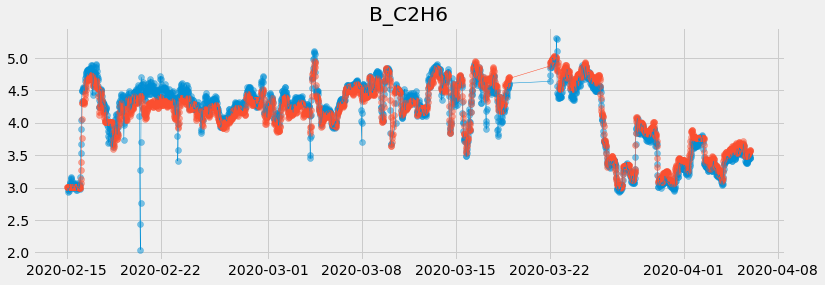

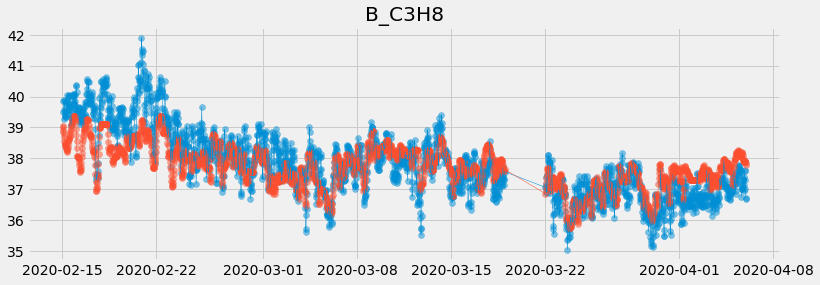

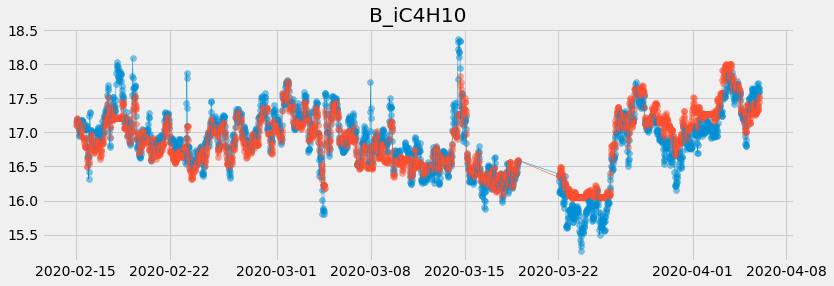

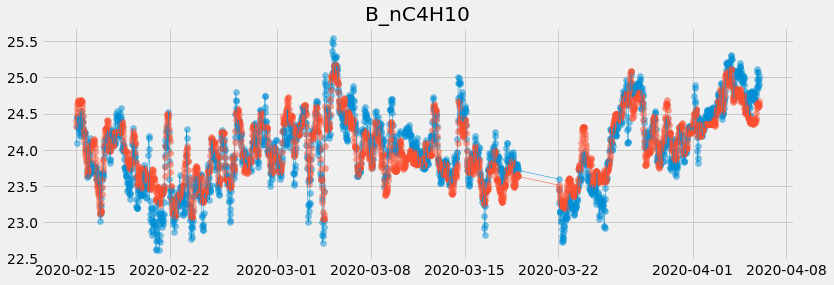

In [16]:
for target in targets:
    fast_plot(train_targets[train_targets_mask][target], title=target, rolling=3)
    fast_plot(train_scaled_coeffed[train_mask][target], new_figure=False)

In [17]:
submission = train_scaled_coeffed[['B_C2H6', 'B_C3H8', 'B_iC4H10', 'B_nC4H10']]['2020-05-01 00:00:00':]
submission

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
timestamp,,,,
2020-05-01 00:00:00,5.039334,35.962646,16.154230,24.480605
2020-05-01 00:30:00,5.039334,35.962646,16.141495,24.486788
2020-05-01 01:00:00,5.039334,35.962646,16.081204,24.485058
2020-05-01 01:30:00,5.039334,35.962646,16.099268,24.478346
2020-05-01 02:00:00,5.039334,35.962646,16.119101,24.472217
...,...,...,...,...
2020-07-22 21:30:00,3.706584,38.283291,17.641355,24.834967
2020-07-22 22:00:00,3.682783,38.184698,17.553011,24.829319
2020-07-22 22:30:00,3.679602,38.102539,17.486602,24.843035


In [18]:
display(submission.isna().sum().to_frame().T)
submission = submission.fillna(method='ffill')
display(submission.isna().sum().to_frame().T)

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
0,0,0,0,0


,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
0,0,0,0,0


In [19]:
submission.to_csv('data/model_baseline.csv')

### Результаты

# 2. Baseline model Sin Prediction Correction

In [20]:
train = pd.read_csv('data/dataset_filtered_1.csv', index_col='timestamp', parse_dates=True)

features = ['A_C2H6', 'A_C3H8', 'A_iC4H10', 'A_nC4H10']
targets = train_targets.columns

In [21]:
targets = train_targets.columns

train_mask = ((train.index > '2020-02-15') & (train.index < '2020-03-19') & (train[targets].sum(axis=1) > 0)) | \
    ((train.index > '2020-03-22') & (train.index < '2020-04-06') & (train[targets].sum(axis=1) > 0))

train_targets_mask = ((train_targets.index > '2020-02-15') & (train_targets.index < '2020-03-19') &
                      (train_targets.sum(axis=1) > 0)) | \
                     ((train_targets.index > '2020-03-22') & (train_targets.index < '2020-04-06') & 
                      (train_targets.sum(axis=1) > 0)) 

In [22]:
def metric_value(y, y_pred):
    return ((y - y_pred)/y).abs().mean()

def mean_metric(y_data, pred_data):
    summary = []
    for col in y_data:
        summary.append(metric_value(y_data[col], pred_data[col]))
        
    return summary

In [23]:
def get_value_by_flow(data, feature, cut_feature, low, high):
    mask = (data[cut_feature] > low) & (data[cut_feature] < high)
    if mask.sum() > 0:
        result = (data[feature][mask] * data['B_rate'][mask]).sum() / data['B_rate'][mask].sum()
        return result
    else:
        return np.NaN

In [24]:
def predict(data, feature, cut_feature, low=13440, high=13150):
    data = data.copy()
    data['Pred'] = np.NaN
    
    for i in range(data.shape[0]): 
        value  =  get_value_by_flow(data, feature, cut_feature, 
                                    data.iloc[i][cut_feature] - low,
                                    data.iloc[i][cut_feature] - high)
        if value > 0:
            data['Pred'].iloc[i] = value
        else:
            data['Pred'].iloc[i] = np.NaN
            
    return data['Pred']

In [25]:
%%time
train['B_C2H6'] = 0
train['B_C3H8'] = 0
train['B_iC4H10'] = 0
train['B_nC4H10'] = 0

train['B_C2H6'] = predict(train, 'A_C2H6', 'B', 13400, 13160)
train['B_C3H8'] = predict(train, 'A_C3H8', 'B', 13380, 13050)
train['B_iC4H10'] = predict(train, 'A_iC4H10', 'B', 13320, 13180)
train['B_nC4H10'] = predict(train, 'A_nC4H10', 'B', 13450, 13100)

C:\Projects\Venvs\Keras\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


Wall time: 1min 48s


In [26]:
print('Unscalled error:', 
      np.round(np.mean(mean_metric(train_targets[train_targets_mask], train[train_mask][targets])) * 100, 3))

Unscalled error: 2.927


### Выбор коэффициентов

In [27]:
def scale_predictions(data, rates):
    data = data.copy()
    for column in rates.columns:
        data[column] *= rates[column].values[0]
    return data

In [28]:
rate = (train_targets[train_targets_mask] / train[train_mask][targets]).describe().loc['50%'].to_frame().T
display(rate)

train_scaled = scale_predictions(train[targets], rate)

print(np.round(metric_value(train_targets[train_targets_mask]['B_C2H6'],train_scaled['B_C2H6'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_C3H8'],train_scaled['B_C3H8'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_iC4H10'],train_scaled['B_iC4H10'][train_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_nC4H10'],train_scaled['B_nC4H10'][train_mask]) * 100, 4))
print(np.round(np.mean(mean_metric(train_targets[train_targets_mask], train_scaled[train_mask][targets])) * 100, 3))

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
50%,0.963581,0.969779,0.97338,0.999642


3.1023
1.7823
1.063
0.8634
1.703


In [29]:
def function_for_optimize(x, y, preds):
    result = np.mean(mean_metric(y, preds * x))
    return result

In [30]:
coefs_dict = {}
targets = train_targets.columns

for target in targets:
    y = train_targets[train_targets_mask][target].to_frame()
    preds = train_scaled[train_mask][target].to_frame()
    x = minimize(function_for_optimize, 1, args=(y, preds),  method='L-BFGS-B', tol=0.0001)['x'][0]
    coefs_dict[target] = x
    
train_scaled_coeffed = train_scaled.copy()
for column in train_scaled.columns:
    train_scaled_coeffed[column] *= coefs_dict[column]

print(np.round(np.mean(mean_metric(train_targets[train_targets_mask], train_scaled_coeffed[train_mask])) * 100, 5))
print(coefs_dict) 

1.70212
{'B_C2H6': 0.9986175811735769, 'B_C3H8': 0.9994461354200084, 'B_iC4H10': 0.9998356225616336, 'B_nC4H10': 0.9998744854900742}


In [31]:
train_scaled_coeffed[train_mask][targets]

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
timestamp,,,,
2020-02-15 00:30:00,3.012490,39.048705,17.104644,24.331663
2020-02-15 01:00:00,3.012490,39.006097,17.152870,24.405706
2020-02-15 01:30:00,3.012490,38.920070,17.204168,24.467418
2020-02-15 02:00:00,3.012490,38.867677,17.193900,24.519475
2020-02-15 02:30:00,3.012490,38.802511,17.161237,24.574045
...,...,...,...,...
2020-04-05 21:30:00,3.556835,37.903202,17.332530,24.604005
2020-04-05 22:00:00,3.560911,37.910381,17.377382,24.592804
2020-04-05 22:30:00,3.564043,37.901591,17.447998,24.603281


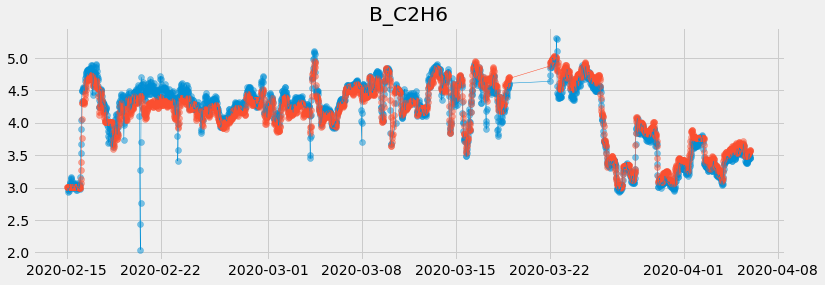

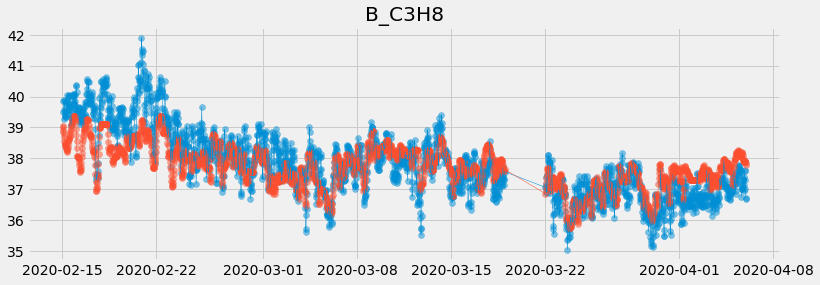

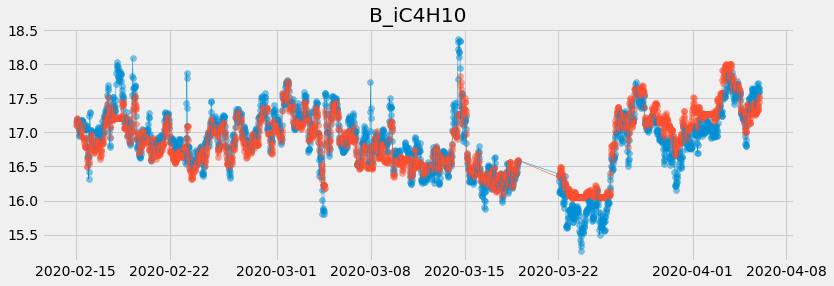

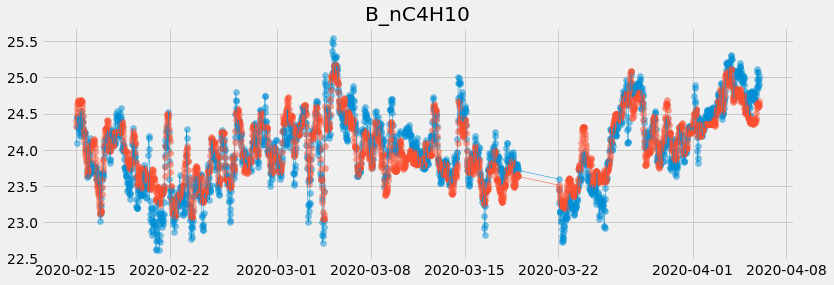

In [32]:
for target in targets:
    fast_plot(train_targets[train_targets_mask][target], title=target, rolling=3)
    fast_plot(train_scaled_coeffed[train_mask][target], new_figure=False)

## Подбор циклов

In [33]:
from scipy.optimize import minimize

In [34]:
# Добавление строк для расчета синусоиды в будущем

train_scaled_coeffed = train_scaled_coeffed[targets].head(9783)
train_scaled_coeffed.index = pd.to_datetime(train_scaled_coeffed.index)
additional_rows = pd.DataFrame(index=[pd.to_datetime('2020-12-14 12:00:00') for _ in  range(2000)], columns=targets)
additional_rows.index.name = 'timestamp'
train_scaled_coeffed = pd.concat([train_scaled_coeffed, additional_rows])

train_scaled_coeffed

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
timestamp,,,,
2020-01-01 04:30:00,NaN,NaN,NaN,NaN
2020-01-01 05:00:00,NaN,NaN,NaN,NaN
2020-01-01 05:30:00,NaN,NaN,NaN,NaN
2020-01-01 06:00:00,NaN,NaN,NaN,NaN
2020-01-01 06:30:00,NaN,NaN,NaN,NaN
...,...,...,...,...
2020-12-14 12:00:00,NaN,NaN,NaN,NaN
2020-12-14 12:00:00,NaN,NaN,NaN,NaN
2020-12-14 12:00:00,NaN,NaN,NaN,NaN


### 'B_C2H6'

In [35]:
def function_for_optimize(params, data, feature, rolling):  
    rolling_data = data[feature].rolling(rolling).mean()
    rate = 2 / (rolling_data.max() - rolling_data.min())
    
    data['x'] = [x for x in range(data.shape[0])]
    data['y'] = data['x'].apply(lambda x: np.sin((x + params[0]) / params[1])) / rate 
    y_shift = rolling_data.min() - (data['y']).min()
    data['y'] += y_shift
    
    mean_diff = (rolling_data - data['y']).abs().mean()
    
    fast_plot(rolling_errors, label='Сглаженные ошибки прогнозов', title=feature)
    fast_plot(data['y'], new_figure=False, label='Функция для корректировки')
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), fontsize=14, ncol=2)
    plt.show()
    
    return mean_diff

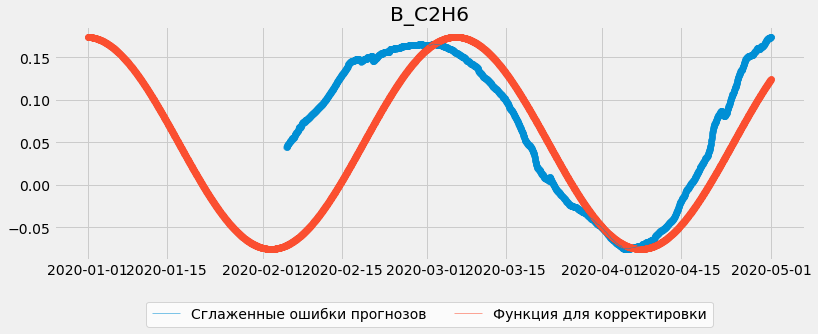

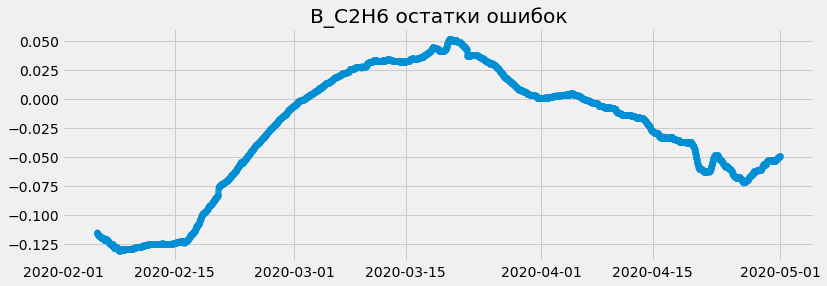

In [36]:
errors = train_targets[targets] - train_scaled_coeffed[targets][:'2020-04-30 23:30']
errors_percent = errors / train_targets[targets][:'2020-04-30 23:30']
errors['B_C2H6']['2020-04-05':'2020-04-12'] = np.NaN
errors['B_C2H6']['2020-01-24':'2020-02-15'] = np.NaN
errors = errors.interpolate()

errors_percent['B_C2H6']['2020-04-05':'2020-04-12'] = np.NaN
errors_percent['B_C2H6']['2020-01-24':'2020-02-15'] = np.NaN
errors_percent = errors_percent.interpolate()

period = 1500
coef = 550
x_shift = 0
rate = 1

coef = 500

rolling_errors = errors['B_C2H6'].rolling(period).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())


errors['x'] = [x + x_shift for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin(x))
y_shift = rolling_errors.min() - (errors['y']/rate).min()


errors['x'] = [x + x_shift for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin(x / coef))
fast_plot(rolling_errors, label='Сглаженные ошибки прогнозов', title='B_C2H6')

x_shift = 800
#x_shift = 500
errors['x'] = [x + x_shift for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin(x / coef))
fast_plot(y_shift + errors['y']/rate, new_figure=False, label='Функция для корректировки')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), fontsize=14, ncol=2)


fast_plot(y_shift + errors['y']/rate - rolling_errors, title='B_C2H6 остатки ошибок')

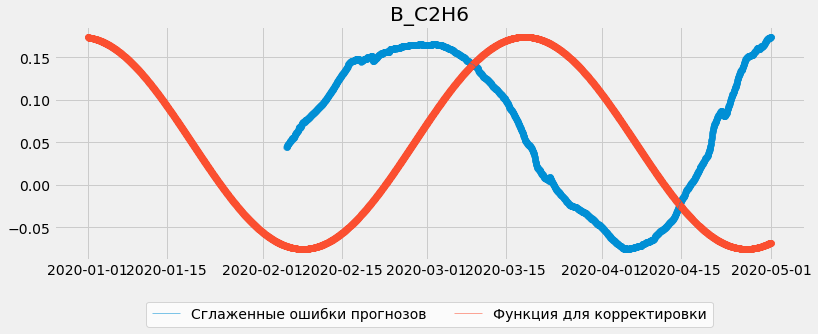

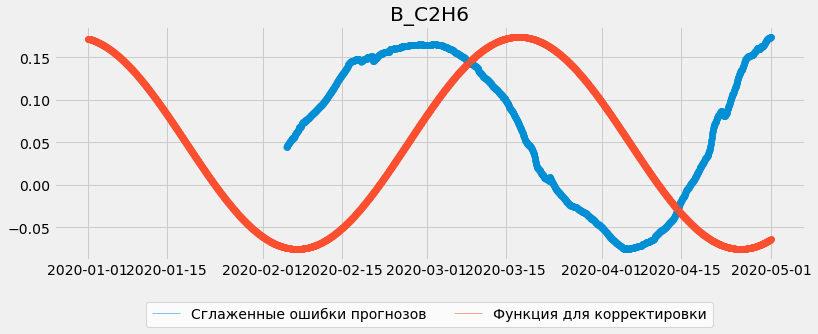

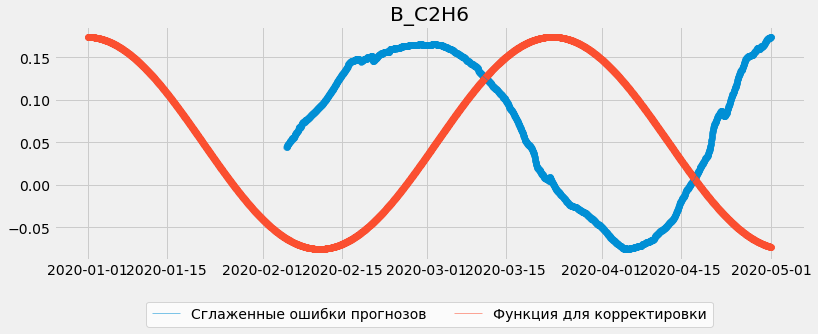

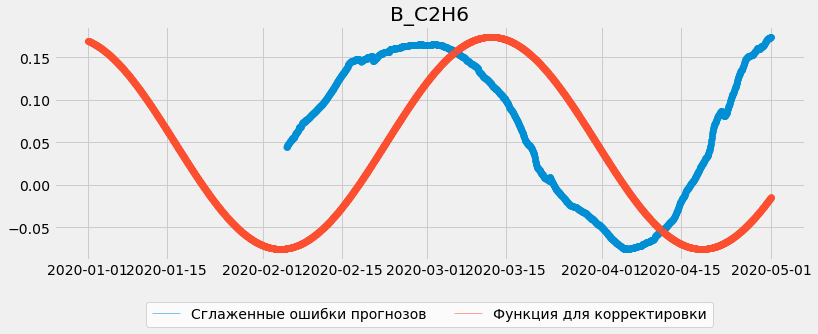

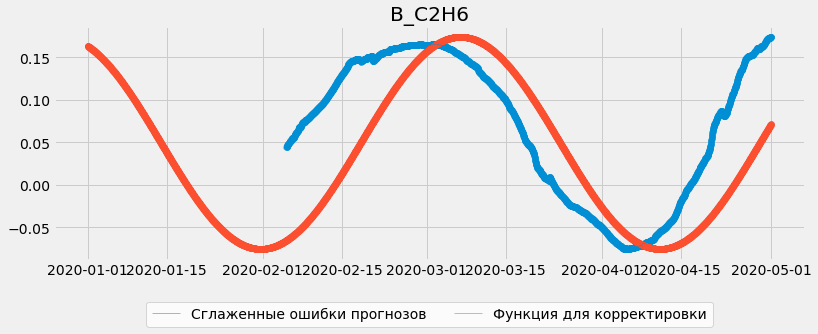

...

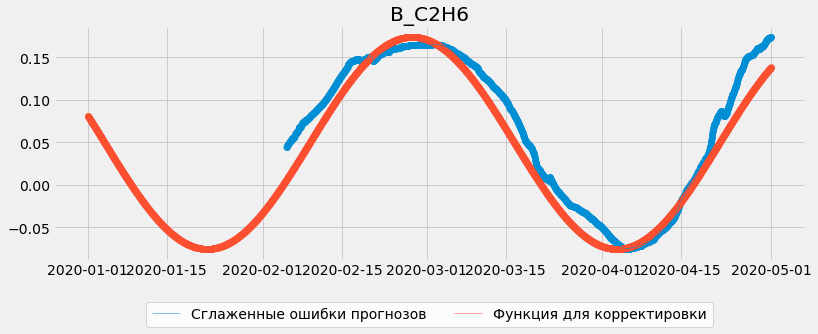

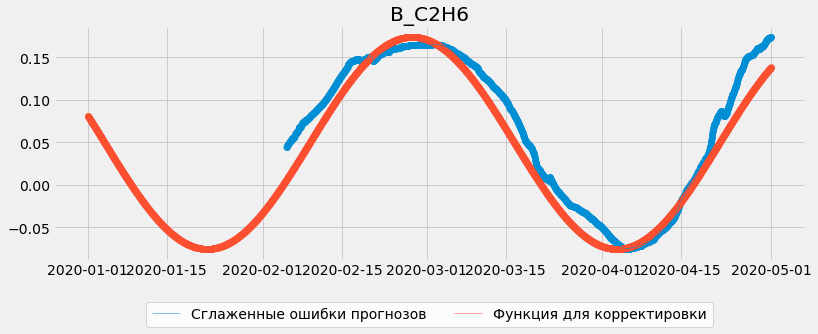

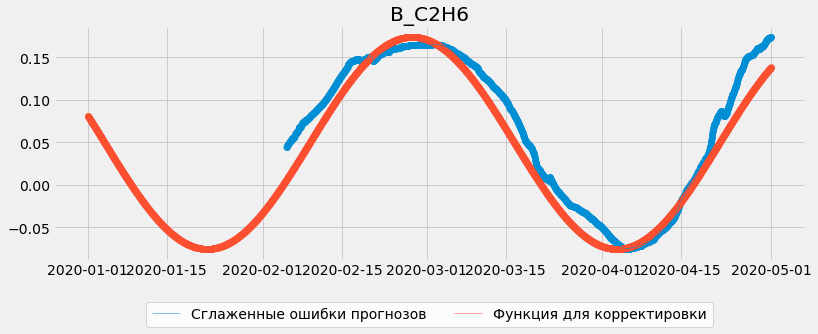

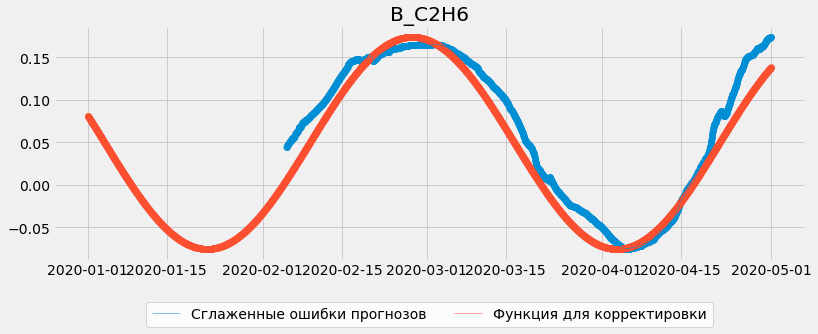

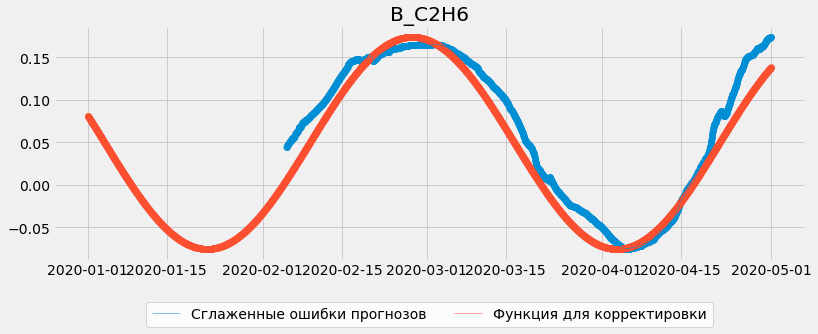

Wall time: 42.2 s


In [37]:
%%time
result = minimize(function_for_optimize, [1000, 600], args=(errors, 'B_C2H6', 1500),
                                        method='Nelder-Mead', tol=0.001)

In [38]:
result

 final_simplex: (array([[1597.79923105,  554.24030983],
       [1597.79825207,  554.24019156],
       [1597.79925988,  554.24031401]]), array([0.01804852, 0.01804852, 0.01804852]))
           fun: 0.01804851869454894
       message: 'Optimization terminated successfully.'
          nfev: 136
           nit: 71
        status: 0
       success: True
             x: array([1597.79923105,  554.24030983])

0.04933729209154612


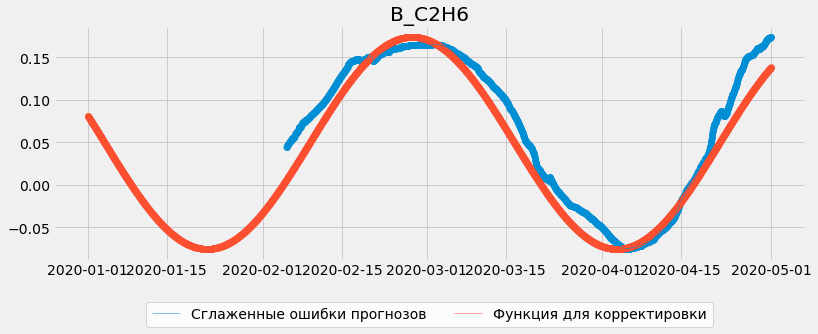

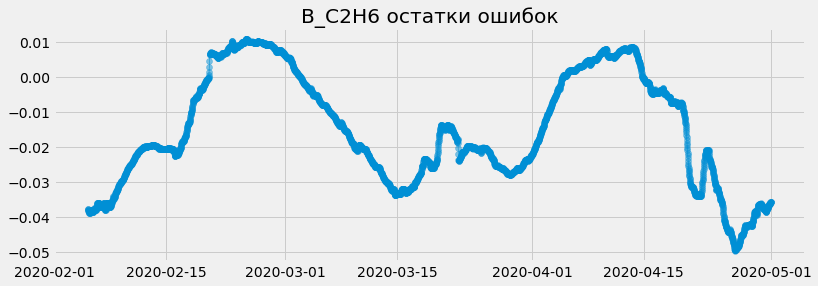

In [39]:
rolling = 1500
x_shift = result['x'][0]
coef = result['x'][1]

rolling_errors = errors['B_C2H6'].rolling(rolling).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())

errors['x'] = [x for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate
y_shift = rolling_errors.min() - (errors['y']).min()
print(y_shift)
errors['y'] += y_shift

fast_plot(rolling_errors, label='Сглаженные ошибки прогнозов', title='B_C2H6')
fast_plot(errors['y'], new_figure=False, label='Функция для корректировки')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), fontsize=14, ncol=2)

fast_plot(errors['y'] - rolling_errors, title='B_C2H6 остатки ошибок')

#### Инференс

In [40]:
y_shift = 0.04933729209154612
x_shift = result['x'][0]
coef = result['x'][1]
rate = 8.03383448692212

train_scaled_coeffed['x'] = [9 + x for x in range(train_scaled_coeffed.shape[0])]
train_scaled_coeffed['y'] = train_scaled_coeffed['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate + y_shift

train_scaled_coeffed['B_C2H6_sin'] = train_scaled_coeffed['B_C2H6'] + train_scaled_coeffed['y'].shift(int(-rolling / 2))

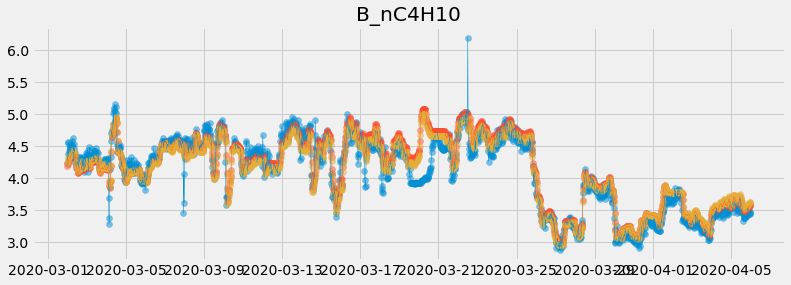

In [41]:
fast_plot(train_targets['B_C2H6']['2020-03-01 23:30':'2020-04-05 23:30'], title=target)
fast_plot(train_scaled_coeffed['B_C2H6']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)
fast_plot(train_scaled_coeffed['B_C2H6_sin']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)

In [42]:
train_scaled_coeffed_mask = train_scaled_coeffed.index.to_series().isin(train[train_mask].index)

In [43]:
print(np.round(metric_value(train_targets[train_targets_mask]['B_C2H6'],
                            train_scaled_coeffed['B_C2H6'][train_scaled_coeffed_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_C2H6'],
                            train_scaled_coeffed['B_C2H6_sin'][train_scaled_coeffed_mask]) * 100, 4))

3.1005
2.8215


### B_C3H8

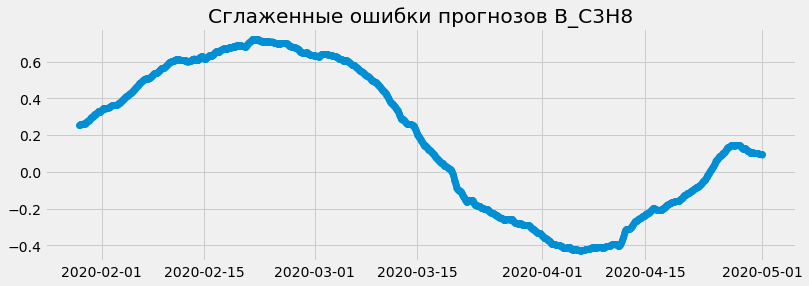

In [44]:
errors = train_targets[targets] - train_scaled_coeffed[targets][:'2020-04-30 23:30']
errors_percent = errors / train_targets[targets][:'2020-04-30 23:30']
errors['B_C3H8'][:'2020-01-05'] = np.NaN
errors['B_C3H8']['2020-04-05':'2020-04-12'] = np.NaN
errors['B_C3H8']['2020-02-01':'2020-02-15'] = np.NaN
errors = errors.interpolate()

fast_plot(errors['B_C3H8'], rolling=1100, title='Сглаженные ошибки прогнозов B_C3H8')

0.14805849144097527


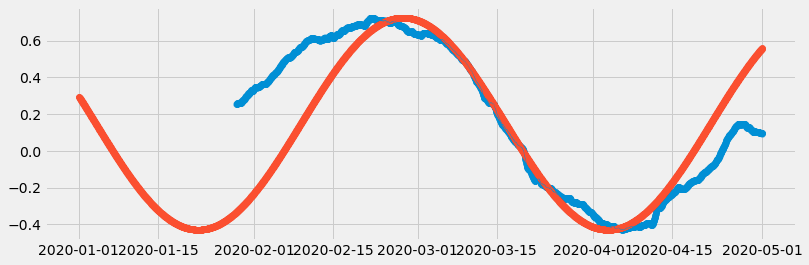

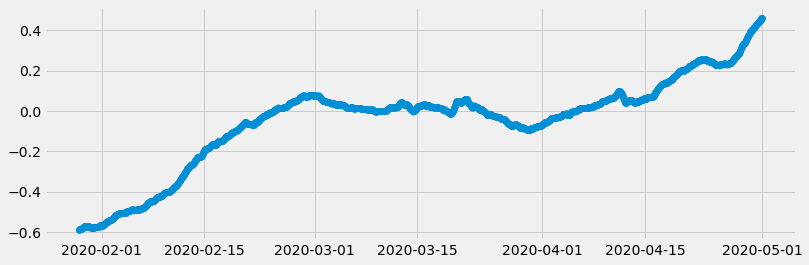

In [45]:
rolling = 1100
x_shift = result['x'][0]
coef = result['x'][1]

rolling_errors = errors['B_C3H8'].rolling(rolling).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())

errors['x'] = [x for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate
y_shift = rolling_errors.min() - (errors['y']).min()
print(y_shift)
errors['y'] += y_shift

fast_plot(rolling_errors, rolling=1)
fast_plot(errors['y'], new_figure=False)
fast_plot(errors['y'] - rolling_errors)

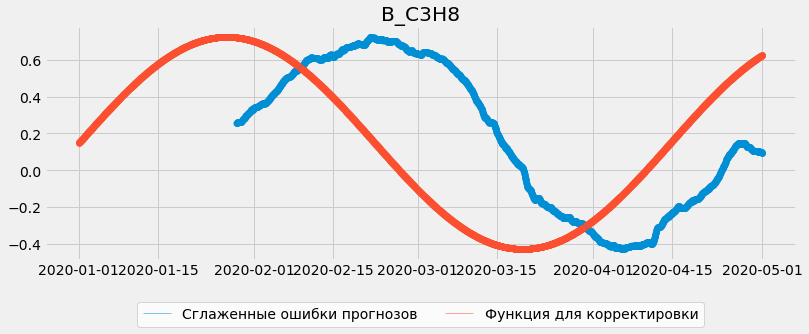

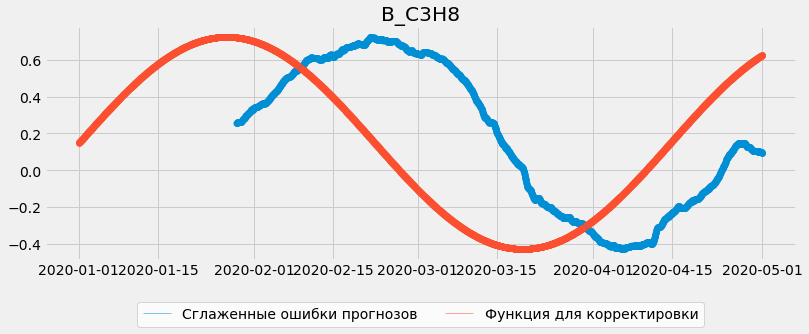

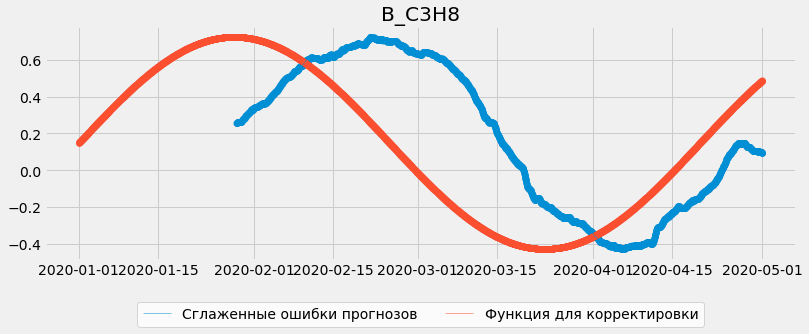

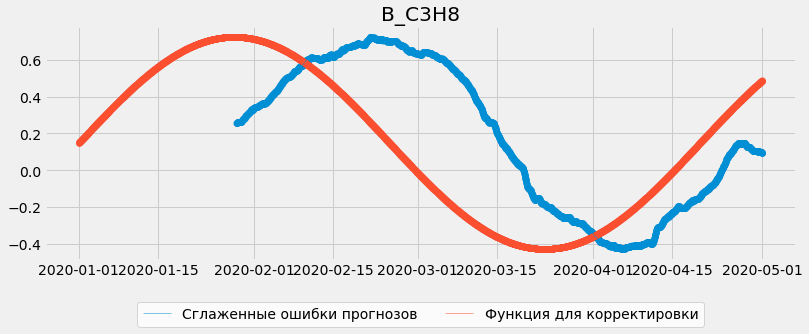

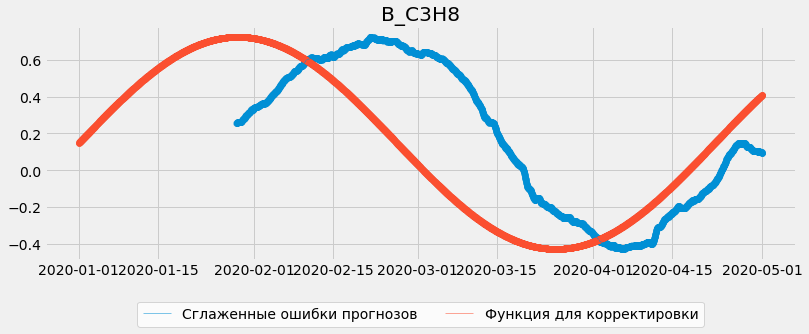

...

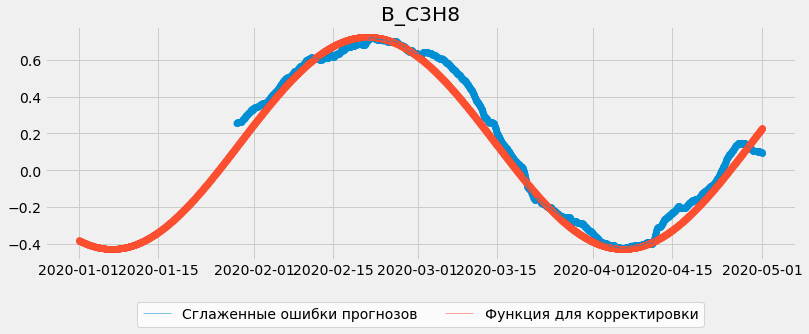

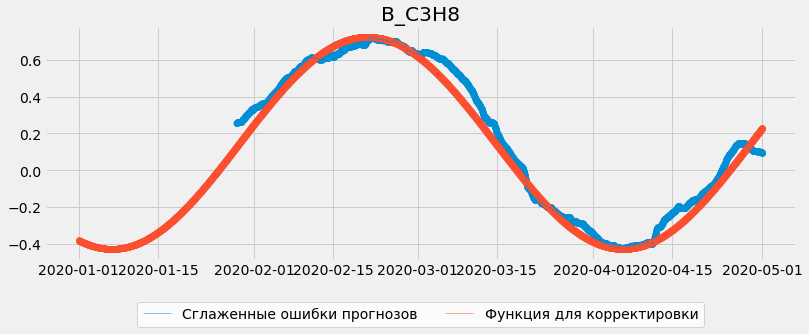

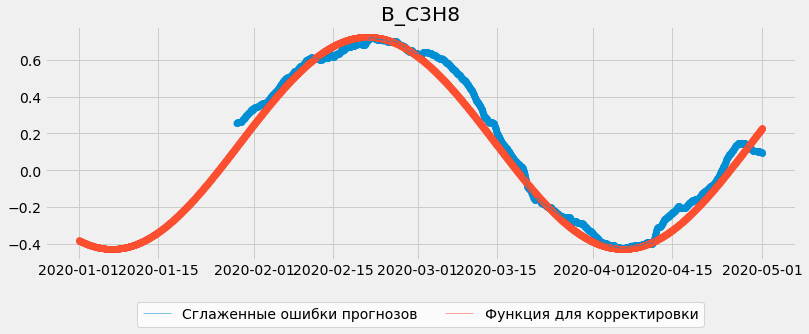

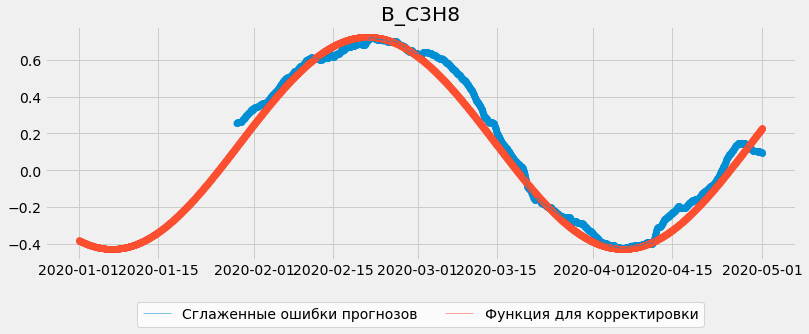

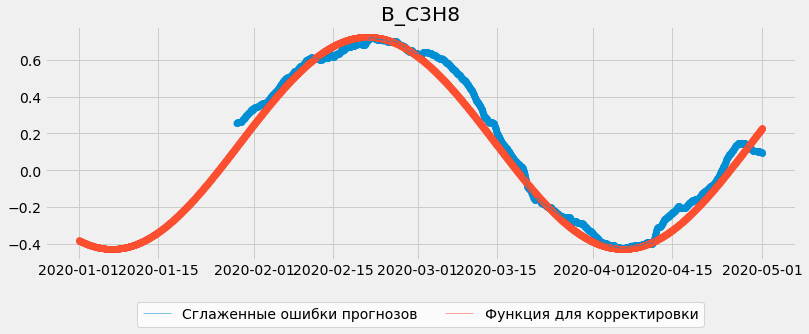

Wall time: 1min 13s


In [46]:
%%time
result = minimize(function_for_optimize, [0, 800], args=(errors, 'B_C3H8', 1100),
                                        method='Nelder-Mead', tol=0.001)

In [47]:
result

 final_simplex: (array([[-1365.95855901,   691.35048988],
       [-1365.95782992,   691.35058604],
       [-1365.95840036,   691.35048464]]), array([0.04713687, 0.04713687, 0.04713687]))
           fun: 0.047136869542670205
       message: 'Optimization terminated successfully.'
          nfev: 245
           nit: 123
        status: 0
       success: True
             x: array([-1365.95855901,   691.35048988])

y_shift: 0.1480584913606553
rate: 1.7337402034118023


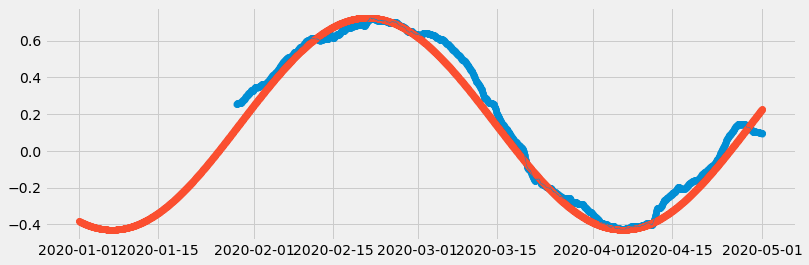

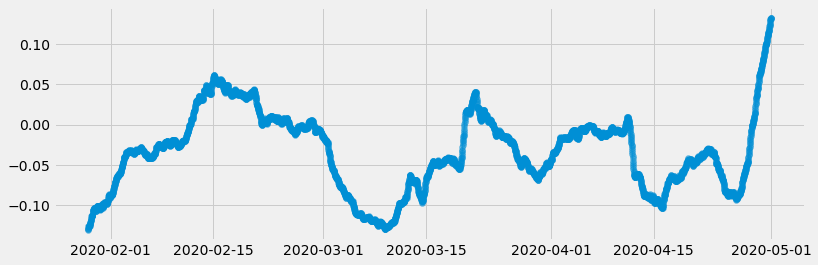

In [48]:
rolling = 1100
x_shift = result['x'][0]
coef = result['x'][1]

rolling_errors = errors['B_C3H8'].rolling(rolling).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())

errors['x'] = [x for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate
y_shift = rolling_errors.min() - (errors['y']).min()
print('y_shift:', y_shift)
print('rate:', rate)
errors['y'] += y_shift

fast_plot(rolling_errors, rolling=1)
fast_plot(errors['y'], new_figure=False)
fast_plot(errors['y'] - rolling_errors)

#### Инференс

In [49]:
y_shift = 0.1480584913606553
x_shift = result['x'][0]
coef = result['x'][1]
rate = 1.7337402034118023

train_scaled_coeffed['x'] = [9 + x for x in range(train_scaled_coeffed.shape[0])]
train_scaled_coeffed['y'] = train_scaled_coeffed['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate + y_shift

train_scaled_coeffed['B_C3H8_sin'] = train_scaled_coeffed['B_C3H8'] + train_scaled_coeffed['y'].shift(int(-rolling / 2))

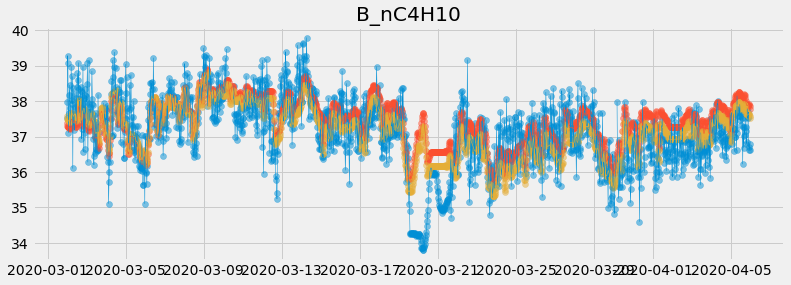

In [50]:
fast_plot(train_targets['B_C3H8']['2020-03-01 23:30':'2020-04-05 23:30'], title=target)
fast_plot(train_scaled_coeffed['B_C3H8']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)
fast_plot(train_scaled_coeffed['B_C3H8_sin']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)

In [51]:
print(np.round(metric_value(train_targets[train_targets_mask]['B_C3H8'],
                            train_scaled_coeffed['B_C3H8'][train_scaled_coeffed_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_C3H8'],
                            train_scaled_coeffed['B_C3H8_sin'][train_scaled_coeffed_mask]) * 100, 4))

1.7818
1.4822


### B_iC4H10

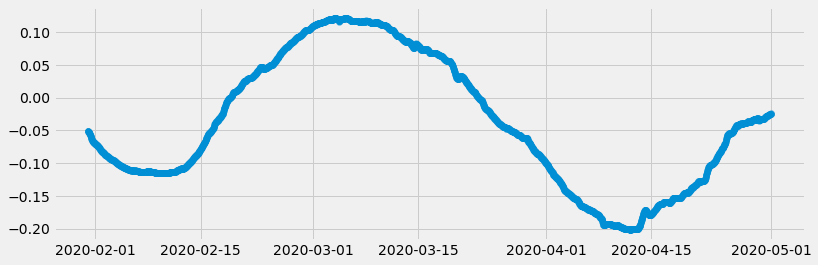

In [52]:
errors = train_targets[targets] - train_scaled_coeffed[targets][:'2020-04-30 23:30']
errors['B_iC4H10'][:'2020-01-05'] = np.NaN
errors['B_iC4H10']['2020-04-05':'2020-04-12'] = np.NaN
errors['B_iC4H10']['2020-02-01':'2020-02-15'] = np.NaN
errors = errors.interpolate()

fast_plot(errors['B_iC4H10'], rolling=1200)

y_shift: -0.03968900317561053
rate: 6.173579091145419


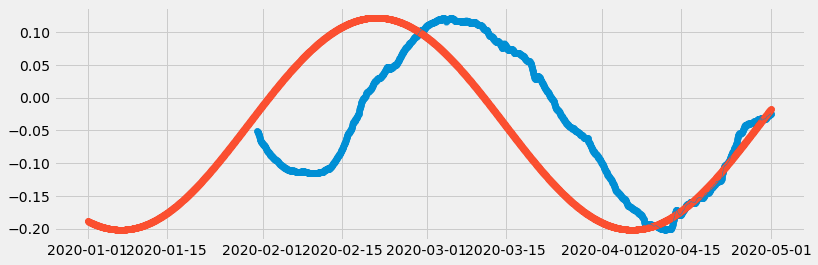

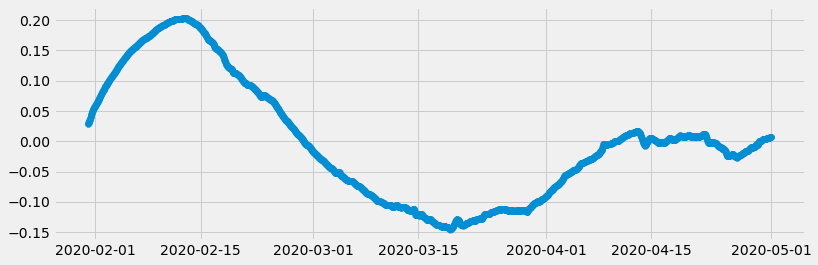

In [53]:
rolling = 1200
x_shift = result['x'][0]
coef = result['x'][1]

rolling_errors = errors['B_iC4H10'].rolling(rolling).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())

errors['x'] = [x for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate
y_shift = rolling_errors.min() - (errors['y']).min()
print('y_shift:', y_shift)
print('rate:', rate)
errors['y'] += y_shift

fast_plot(rolling_errors, rolling=1)
fast_plot(errors['y'], new_figure=False)
fast_plot(errors['y'] - rolling_errors)

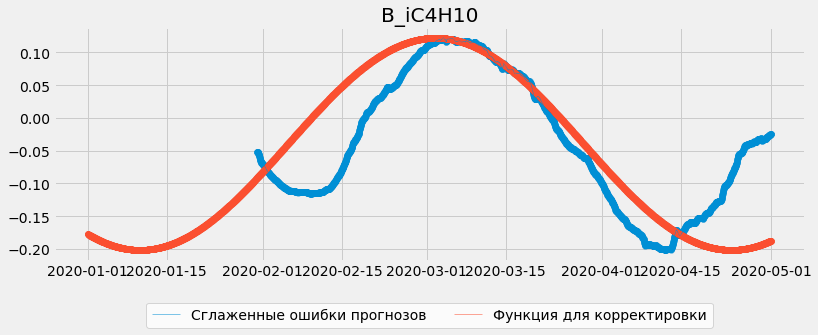

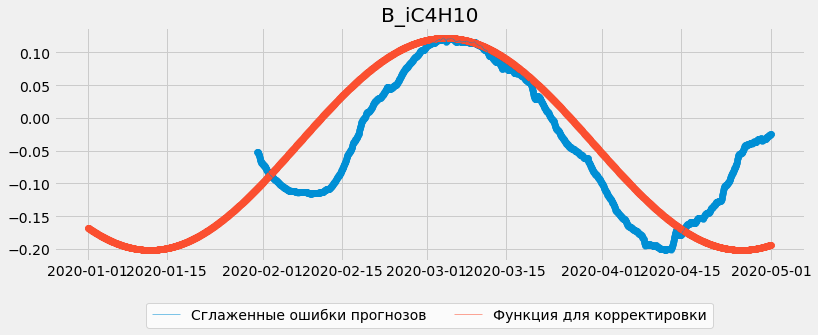

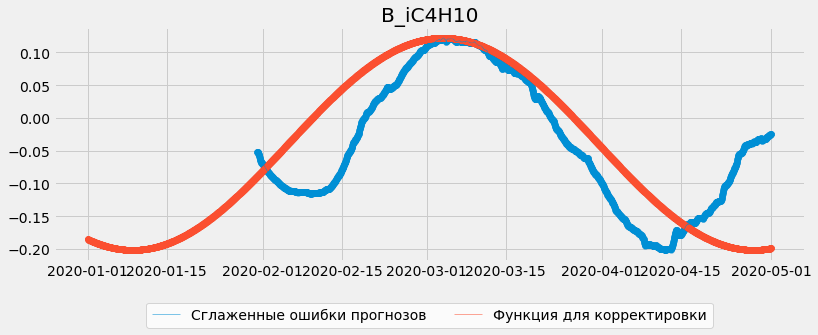

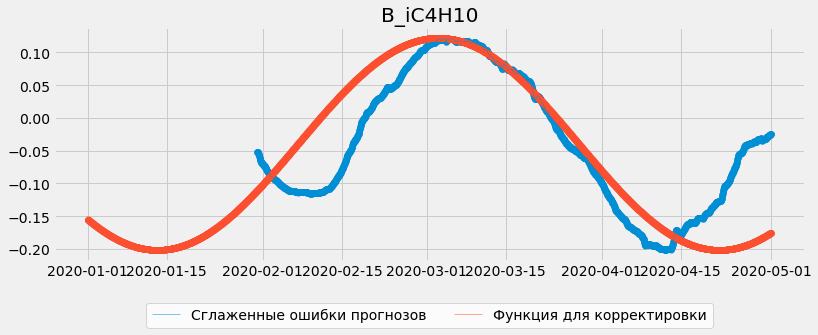

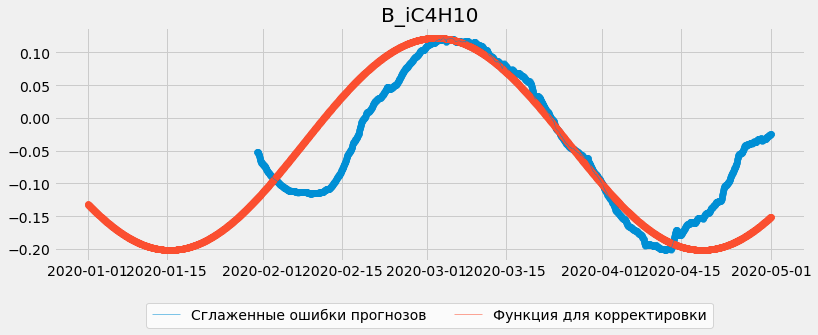

...

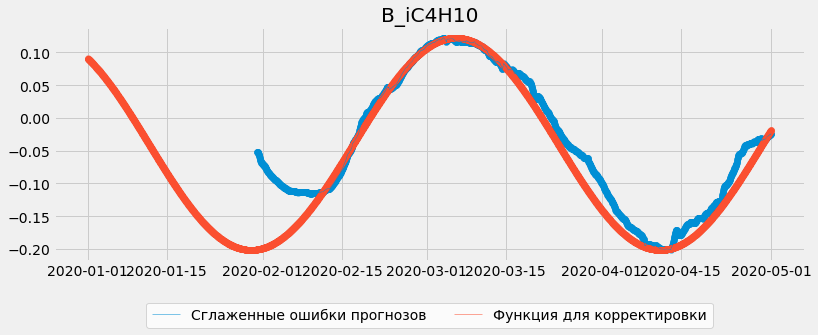

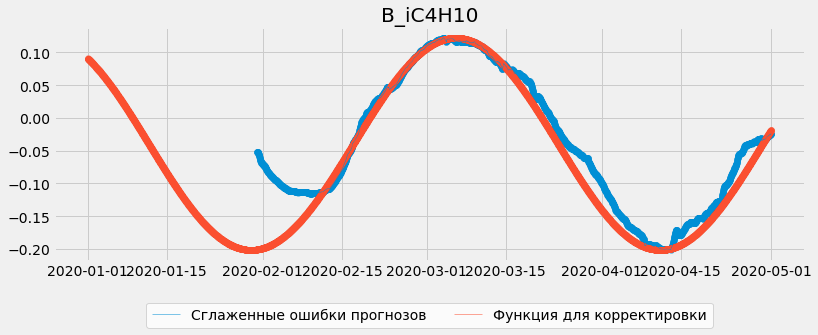

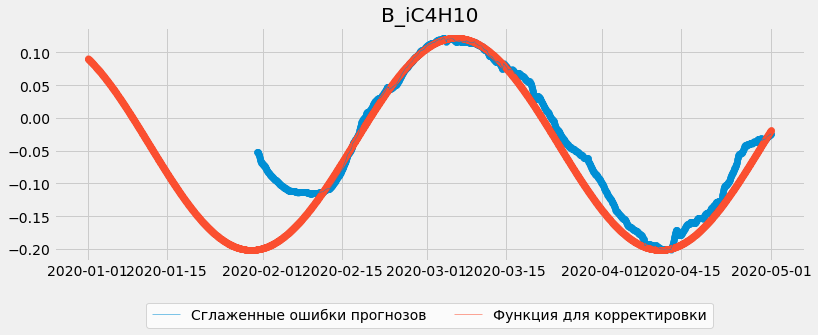

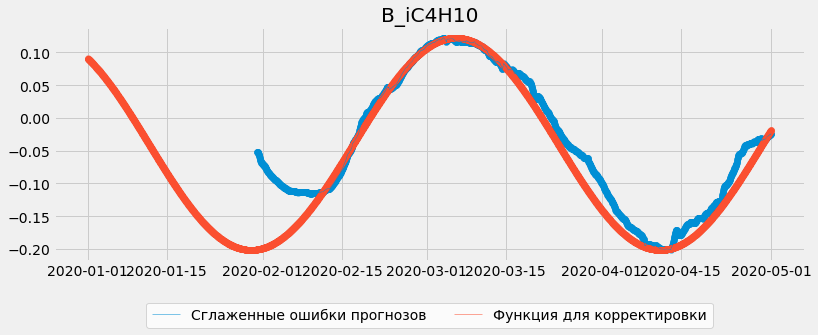

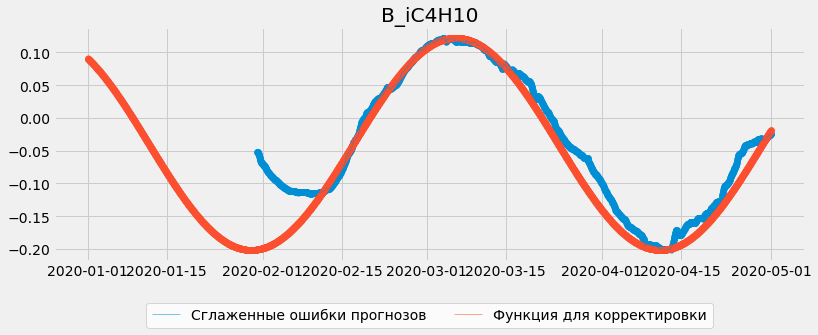

Wall time: 36.1 s


In [54]:
%%time
result = minimize(function_for_optimize, [-1700, 800], args=(errors, 'B_iC4H10', 1200),
                  method='Nelder-Mead', tol=0.001)

In [55]:
result

 final_simplex: (array([[-2256.8256641 ,   553.47394048],
       [-2256.82478933,   553.47408157],
       [-2256.82530276,   553.4740129 ]]), array([0.0210861, 0.0210861, 0.0210861]))
           fun: 0.02108609510345217
       message: 'Optimization terminated successfully.'
          nfev: 114
           nit: 63
        status: 0
       success: True
             x: array([-2256.8256641 ,   553.47394048])

y_shift: -0.03968900317748153
rate: 6.173579091145419


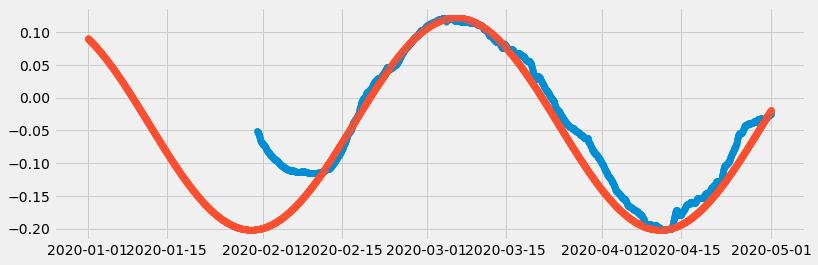

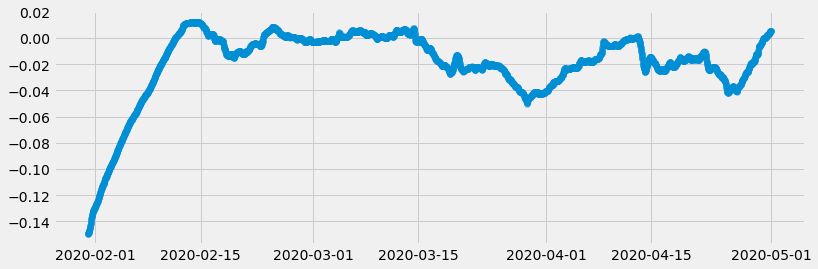

In [56]:
rolling = 1200
x_shift = result['x'][0]
coef = result['x'][1]

rolling_errors = errors['B_iC4H10'].rolling(rolling).mean()
rate = 2 / (rolling_errors.max() - rolling_errors.min())

errors['x'] = [x for x in range(errors.shape[0])]
errors['y'] = errors['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate
y_shift = rolling_errors.min() - (errors['y']).min()
print('y_shift:', y_shift)
print('rate:', rate)
errors['y'] += y_shift

fast_plot(rolling_errors, rolling=1)
fast_plot(errors['y'], new_figure=False)
fast_plot(errors['y'] - rolling_errors)

#### Инференс

In [57]:
x_shift = result['x'][0]
coef = result['x'][1]

train_scaled_coeffed['x'] = [9 + x for x in range(train_scaled_coeffed.shape[0])]
train_scaled_coeffed['y'] = train_scaled_coeffed['x'].apply(lambda x: np.sin((x + x_shift)/coef)) / rate + y_shift

train_scaled_coeffed['B_iC4H10_sin'] = train_scaled_coeffed['B_iC4H10'] + train_scaled_coeffed['y'].shift(int(-rolling / 2))

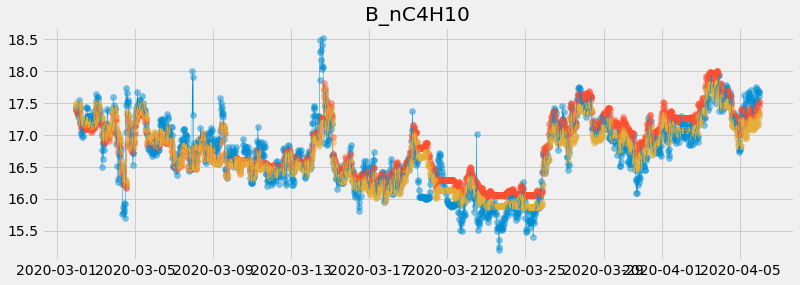

In [58]:
fast_plot(train_targets['B_iC4H10']['2020-03-01 23:30':'2020-04-05 23:30'], title=target)
fast_plot(train_scaled_coeffed['B_iC4H10']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)
fast_plot(train_scaled_coeffed['B_iC4H10_sin']['2020-03-01 23:30':'2020-04-05 23:30'], new_figure=False)

In [59]:
print(np.round(metric_value(train_targets[train_targets_mask]['B_iC4H10'],
                            train_scaled_coeffed['B_iC4H10'][train_scaled_coeffed_mask]) * 100, 4))
print(np.round(metric_value(train_targets[train_targets_mask]['B_iC4H10'],
                            train_scaled_coeffed['B_iC4H10_sin'][train_scaled_coeffed_mask]) * 100, 4))

1.0629
0.8793


### B_nC4H10

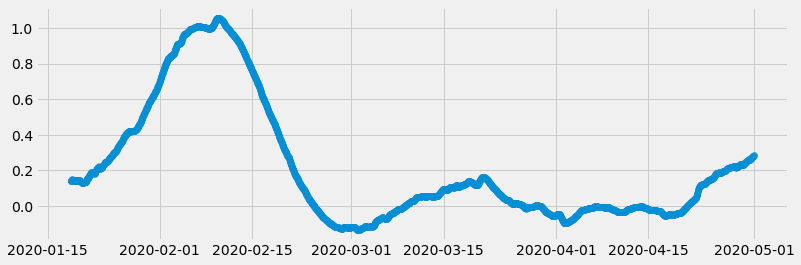

In [60]:
errors = train_targets[targets] - train_scaled_coeffed[targets][:'2020-04-30 23:30']
errors['B_nC4H10'][:'2020-01-05'] = np.NaN
errors['B_nC4H10']['2020-04-05':'2020-04-12'] = np.NaN
errors['B_nC4H10']['2020-02-01':'2020-02-15'] = np.NaN
errors = errors.interpolate()

fast_plot(errors['B_nC4H10'], rolling=600)

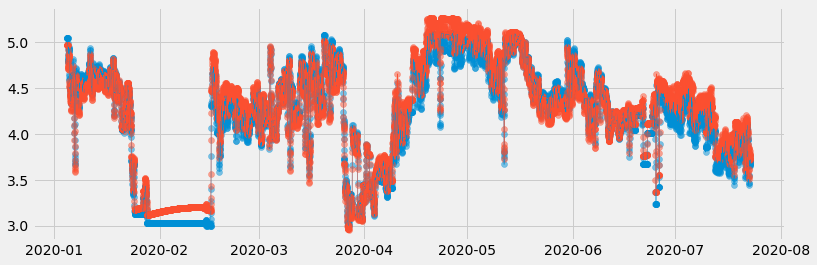

In [61]:
fast_plot(train_scaled_coeffed['B_C2H6'])
fast_plot(train_scaled_coeffed['B_C2H6_sin'], new_figure=False)

### Submission

In [62]:
train_scaled_coeffed.head()

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10,x,y,B_C2H6_sin,B_C3H8_sin,B_iC4H10_sin
timestamp,,,,,,,,,
2020-01-01 04:30:00,NaN,NaN,NaN,NaN,9,0.089155,NaN,NaN,NaN
2020-01-01 05:00:00,NaN,NaN,NaN,NaN,10,0.088977,NaN,NaN,NaN
2020-01-01 05:30:00,NaN,NaN,NaN,NaN,11,0.088799,NaN,NaN,NaN
2020-01-01 06:00:00,NaN,NaN,NaN,NaN,12,0.088621,NaN,NaN,NaN
2020-01-01 06:30:00,NaN,NaN,NaN,NaN,13,0.088442,NaN,NaN,NaN


In [63]:
submission = train_scaled_coeffed[['B_C2H6_sin', 'B_C3H8_sin', 'B_iC4H10_sin', 'B_nC4H10']]['2020-05-01 00:00:00':'2020-07-22 23:30:00']
submission.columns = targets
submission

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
timestamp,,,,
2020-05-01 00:00:00,5.192918,36.575651,16.266491,24.480605
2020-05-01 00:30:00,5.192795,36.576144,16.253857,24.486788
2020-05-01 01:00:00,5.192672,36.576636,16.193666,24.485058
2020-05-01 01:30:00,5.192548,36.577127,16.211831,24.478346
2020-05-01 02:00:00,5.192424,36.577618,16.231763,24.472217
...,...,...,...,...
2020-07-22 21:30:00,3.767936,38.661126,17.739573,24.834967
2020-07-22 22:00:00,3.743911,38.563298,17.651076,24.829319
2020-07-22 22:30:00,3.740507,38.481903,17.584512,24.843035


In [64]:
display(submission.isna().sum().to_frame().T)
submission = submission.fillna(method='ffill')
display(submission.isna().sum().to_frame().T)

,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
0,0,0,0,0


,B_C2H6,B_C3H8,B_iC4H10,B_nC4H10
0,0,0,0,0


In [65]:
submission.to_csv('data/model_baseline_sin.csv')

### Результаты